In [67]:
import numpy as np
import cv2

images = [cv2.imread('data/hyu_{}.jpeg'.format(i)) for i in range(3)]
grays = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]


sift = cv2.xfeatures2d.SIFT_create()
kps = []
descs = []
for gray in grays:
    kp, desc = sift.detectAndCompute(gray, None)
    kps.append(kp)
    descs.append(desc)

bf = cv2.BFMatcher()
matches1 = bf.match(descs[0], descs[1])     # between image 0 and image 1
matches2 = bf.match(descs[2], descs[1])     # between image 2 and image 1

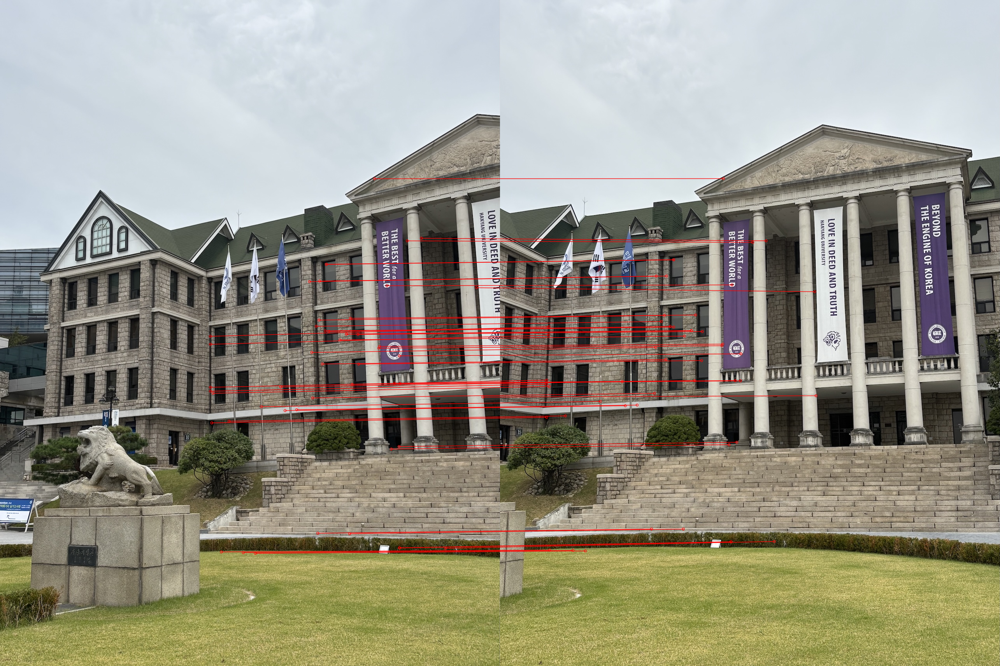

In [68]:

sorted_matches = sorted(matches1, key = lambda x : x.distance)
res = cv2.drawMatches(images[0], kps[0], images[1], kps[1], sorted_matches[:50], None, matchColor = (0,0,255), flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

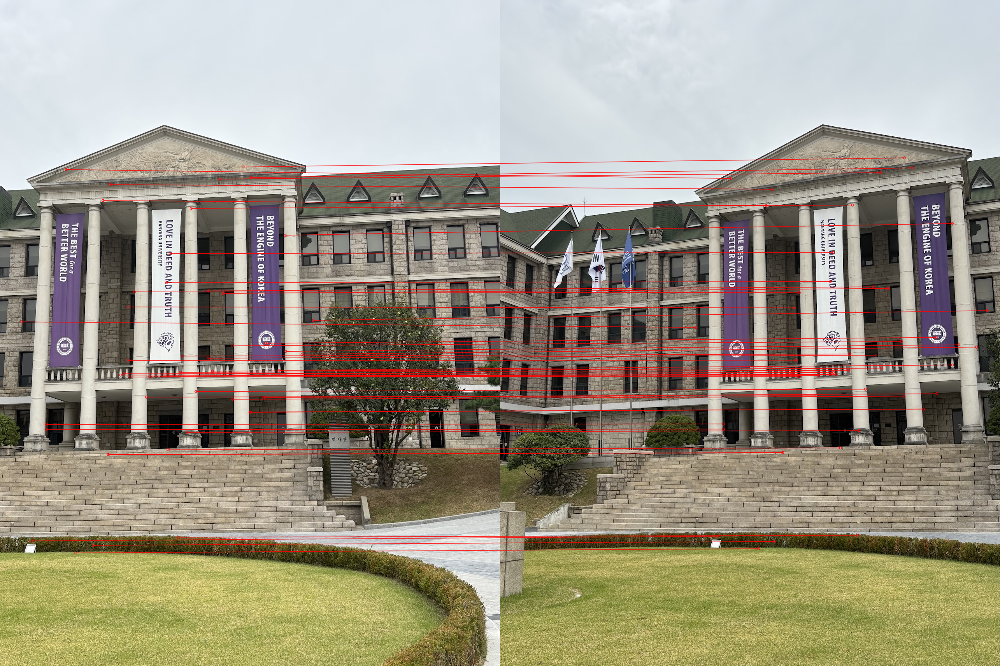

In [69]:
sorted_matches = sorted(matches2, key = lambda x : x.distance)
res = cv2.drawMatches(images[2], kps[2], images[1], kps[1], sorted_matches[:50], None, matchColor = (0,0,255), flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

In [ ]:
height, width, _ = images[0].shape
result = np.zeros((height, width * 3, 3), dtype = np.uint8)

# Stitch image2 to image1
src = np.float32([kps[2][m.queryIdx].pt for m in matches2]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches2]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)

# Prepare pixel coordinates in image2
before = []
for x in range(images[2].shape[1]):
    for y in range(images[2].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

# [TODO] Calculate coordinates for each pixel in image1 to image 2
after = H @ before
after /= after[2, :]
after = after[:2, :]
after = np.round(after, 0).astype(int)


for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] >= height:
        continue

    if np.sum(pt2 < 0) >= 1:
        continue

    result[pt2[1], width+pt2[0]] = images[2][pt1[1], pt1[0]]


# Stitch image0 to image1
src = np.float32([kps[0][m.queryIdx].pt for m in matches1]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches1]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)


# Prepare pixel coordinates in image0
before = []
for x in range(images[0].shape[1]):
    for y in range(images[0].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

# [TODO] Calculate coordinates for each pixel in image1 to image 0
after = H @ before
after /= after[2, :]
after = after[:2, :]
after = np.round(after, 0).astype(int)
after[0] += width

for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] < 0 or pt2[1] >= height:
        continue

    if any(pt2 < 0):
        continue

    result[pt2[1], pt2[0]] = images[0][pt1[1], pt1[0]]
result[0:height, width:width*2] = images[1]

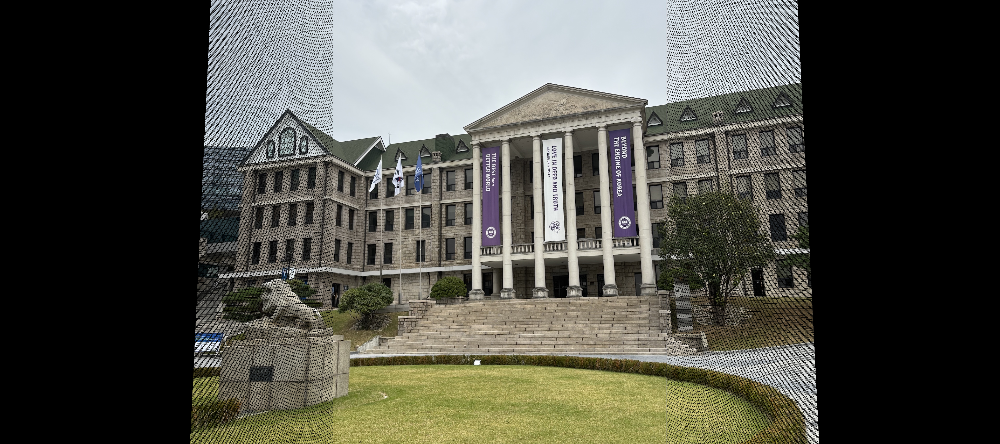

In [71]:
from PIL import Image
Image.fromarray(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

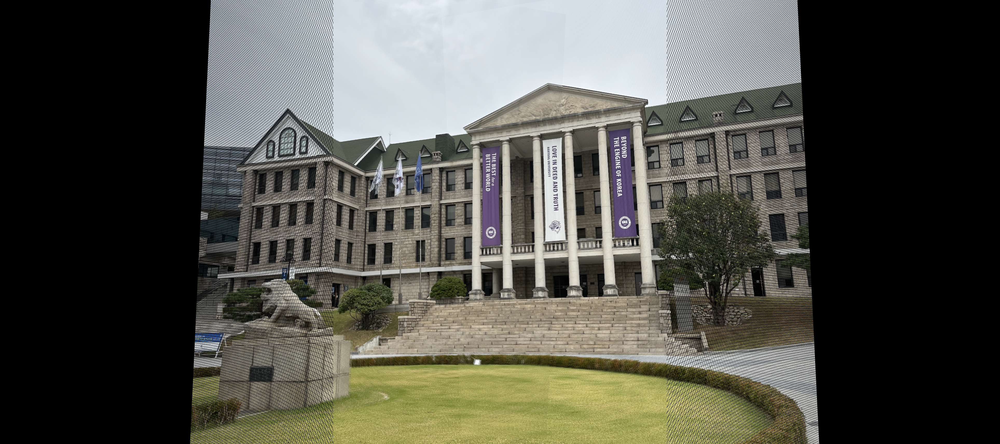

In [22]:
height, width, _ = images[0].shape
result = np.zeros((height, width * 3, 3), dtype=np.float32)
weight = np.zeros((height, width * 3), dtype=np.float32)

# Blending 함수
def blend_pixel(target, weight_map, x, y, color, alpha=1.0):
    if 0 <= y < target.shape[0] and 0 <= x < target.shape[1]:
        weight_map[y, x] += alpha
        target[y, x] += color * alpha

# Stitch image2 to image1
src = np.float32([kps[2][m.queryIdx].pt for m in matches2]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches2]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)

before = np.array([[x, y, 1] for x in range(images[1].shape[1]) for y in range(images[1].shape[0])]).T
after = H @ before
after /= after[2, :]
after = np.round(after[:2, :]).astype(int)

for pt1, pt2 in zip(before[:2, :].T, after.T):
    if pt2[1] < 0 or pt2[1] >= height or pt2[0] + width >= result.shape[1] or pt2[0] < 0:
        continue
    blend_pixel(result, weight, width + pt2[0], pt2[1], images[2][pt1[1], pt1[0]])

# Stitch image0 to image1
src = np.float32([kps[0][m.queryIdx].pt for m in matches1]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches1]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)

before = np.array([[x, y, 1] for x in range(images[1].shape[1]) for y in range(images[1].shape[0])]).T
after = H @ before
after /= after[2, :]
after = np.round(after[:2, :]).astype(int)
after[0] += width

for pt1, pt2 in zip(before[:2, :].T, after.T):
    if pt2[1] < 0 or pt2[1] >= height or pt2[0] < 0 or pt2[0] >= result.shape[1]:
        continue
    blend_pixel(result, weight, pt2[0], pt2[1], images[0][pt1[1], pt1[0]])

# 이미지1을 중앙에 추가하면서 blending 수행
for y in range(height):
    for x in range(width):
        blend_pixel(result, weight, width + x, y, images[1][y, x])

# Normalize the blended result
weight[weight == 0] = 1  # Avoid division by zero
result /= weight[:, :, None]
result = np.clip(result, 0, 255).astype(np.uint8)

# 결과 출력
from PIL import Image
Image.fromarray(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

Using pypi Stitching


In [41]:
from matplotlib import pyplot as plt
import cv2 as cv
import numpy as np

def plot_image(img, figsize_in_inches=(5,5)):
    fig, ax = plt.subplots(figsize=figsize_in_inches)
    ax.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
    plt.show()
    
def plot_images(imgs, figsize_in_inches=(5,5)):
    fig, axs = plt.subplots(1, len(imgs), figsize=figsize_in_inches)
    for col, img in enumerate(imgs):
        axs[col].imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
    plt.show()

In [36]:
import numpy as np
import cv2
from pathlib import Path
def get_image_paths(img_dir, img_set):
    return sorted([str(path) for path in Path(img_dir).rglob(f'{img_set}*')])

# 이미지 경로 지정
img_dir = '/Users/dain/Library/Mobile Documents/com~apple~CloudDocs/HANYANG/1_2/3Dvision_PA/HYU-2024-AUE8089/data'
img_set = 'hyu'

# 이미지 불러오기
image_path= get_image_paths(img_dir, img_set)


In [30]:
print(images)

['/Users/dain/Library/Mobile Documents/com~apple~CloudDocs/HANYANG/1_2/3Dvision_PA/HYU-2024-AUE8089/data/hyu_0.jpeg', '/Users/dain/Library/Mobile Documents/com~apple~CloudDocs/HANYANG/1_2/3Dvision_PA/HYU-2024-AUE8089/data/hyu_1.jpeg', '/Users/dain/Library/Mobile Documents/com~apple~CloudDocs/HANYANG/1_2/3Dvision_PA/HYU-2024-AUE8089/data/hyu_2.jpeg']


In [39]:
from stitching.images import Images
# 이미지 읽기
images = [cv2.imread(path) for path in image_path]

# None 값 제거 (이미지 로드 실패 방지)
images = [img for img in images if img is not None]

# 이미지 스티칭 객체 생성
images = Images.of(images)
image_list = list(images)


In [40]:
from stitching.feature_detector import FeatureDetector

finder = FeatureDetector()
features = [finder.detect_features(img) for img in image_list]
keypoints_center_img = finder.draw_keypoints(image_list[1], features[1])

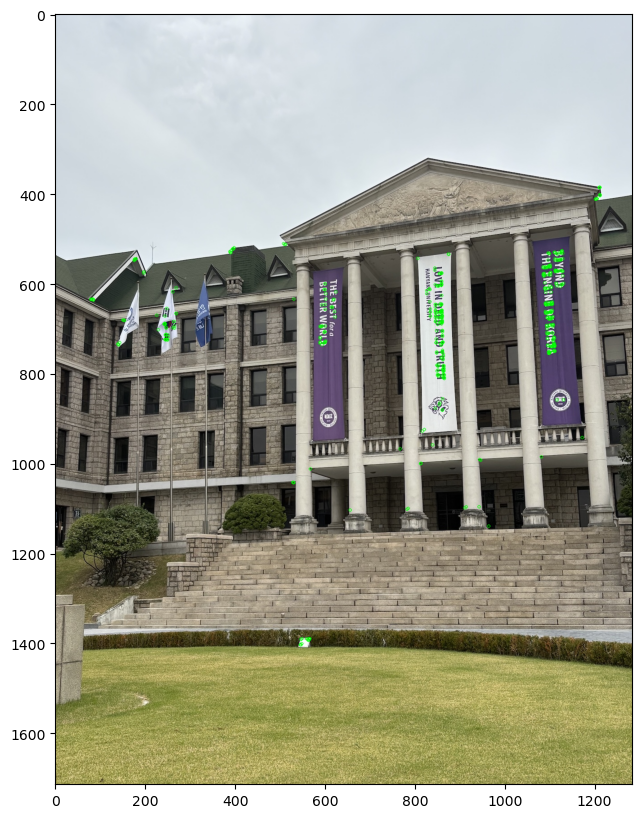

In [42]:
plot_image(keypoints_center_img, (15,10))

In [43]:
from stitching.feature_matcher import FeatureMatcher

matcher = FeatureMatcher()
matches = matcher.match_features(features)

Matches Image 1 to Image 2


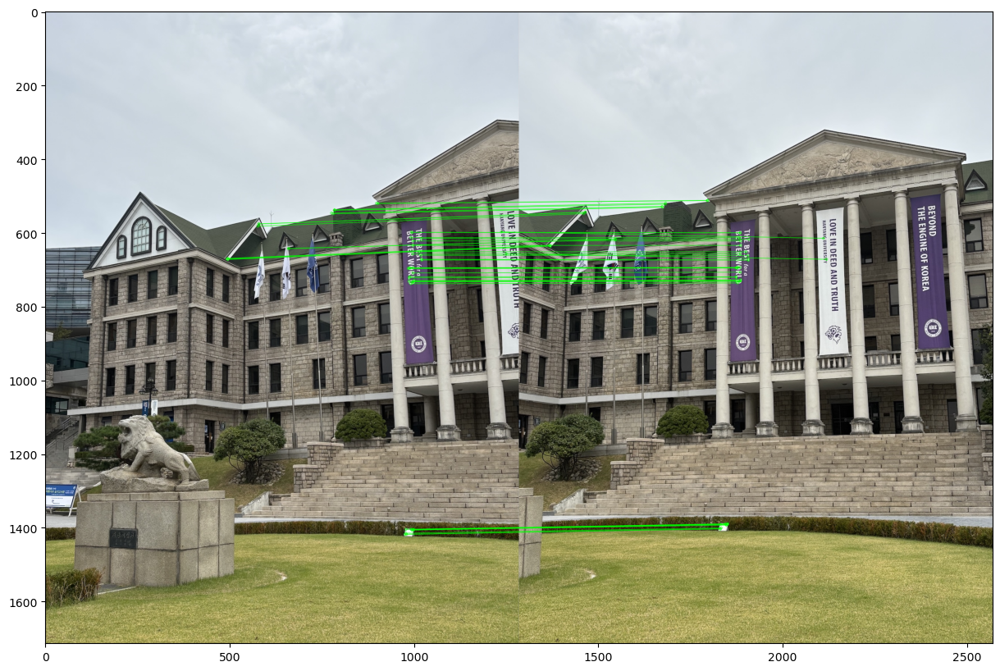

Matches Image 2 to Image 3


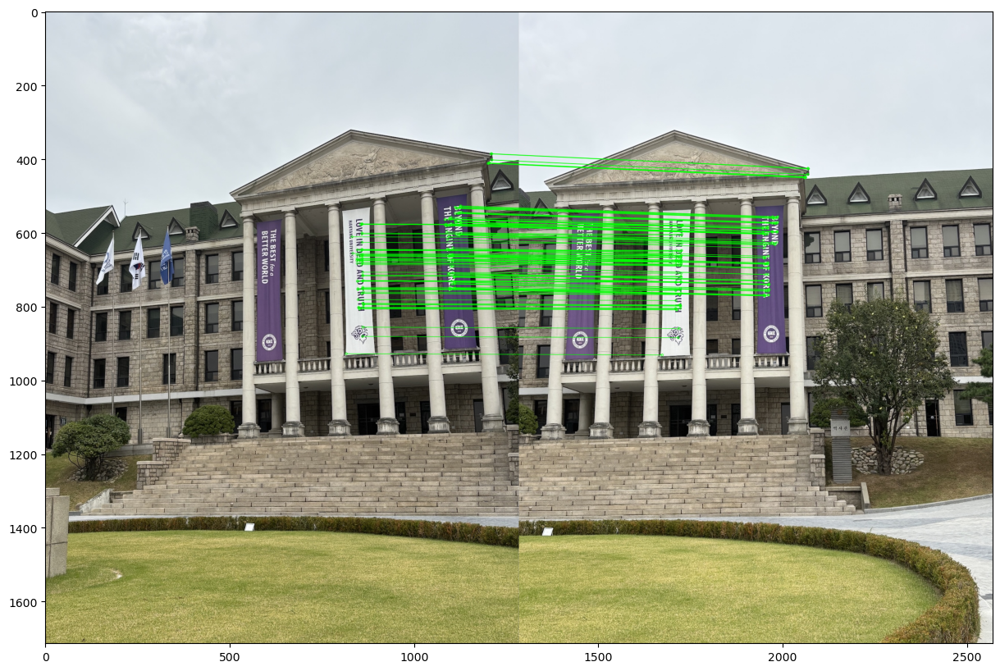

In [44]:
all_relevant_matches = matcher.draw_matches_matrix(image_list, features, matches, conf_thresh=1, 
                                                   inliers=True, matchColor=(0, 255, 0))

for idx1, idx2, img in all_relevant_matches:
    print(f"Matches Image {idx1+1} to Image {idx2+1}")
    plot_image(img, (20,10))

In [45]:
from stitching.subsetter import Subsetter

subsetter = Subsetter()
dot_notation = subsetter.get_matches_graph(images.names, matches)
print(dot_notation)

graph matches_graph{
"1" -- "2"[label="Nm=101, Ni=52, C=1.3577"];
"2" -- "3"[label="Nm=196, Ni=142, C=2.12575"];
}


camera estimation, adjustion and correction

In [47]:
from stitching.camera_estimator import CameraEstimator
from stitching.camera_adjuster import CameraAdjuster
from stitching.camera_wave_corrector import WaveCorrector

camera_estimator = CameraEstimator()
camera_adjuster = CameraAdjuster()
wave_corrector = WaveCorrector()

cameras = camera_estimator.estimate(features, matches)
cameras = camera_adjuster.adjust(features, matches, cameras)
cameras = wave_corrector.correct(cameras)

In [46]:
from stitching.warper import Warper

warper = Warper()

In [48]:
warper.set_scale(cameras)

In [54]:
low_sizes = images.get_scaled_img_sizes(Images.Resolution.FINAL)
camera_aspect = images.get_ratio(Images.Resolution.MEDIUM, Images.Resolution.FINAL)  # since cameras were obtained on medium imgs

warped_final_imgs = list(warper.warp_images(image_list, cameras, camera_aspect))
warped_final_masks = list(warper.create_and_warp_masks(low_sizes, cameras, camera_aspect))
final_corners, final_sizes = warper.warp_rois(low_sizes, cameras, camera_aspect)

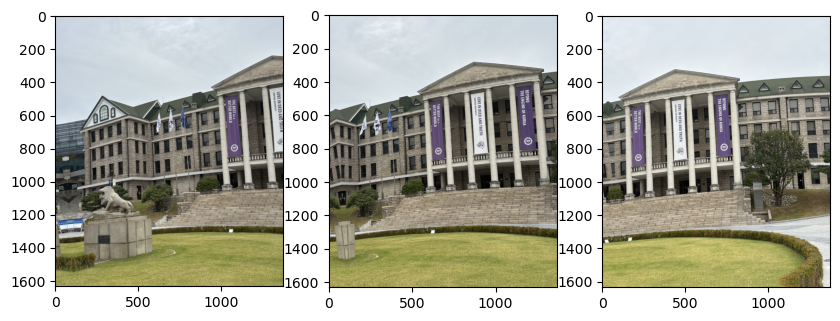

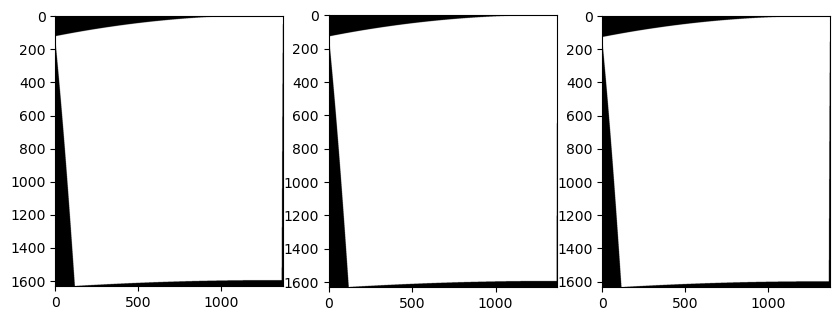

In [52]:
plot_images(warped_low_imgs, (10,10))
plot_images(warped_low_masks, (10,10))

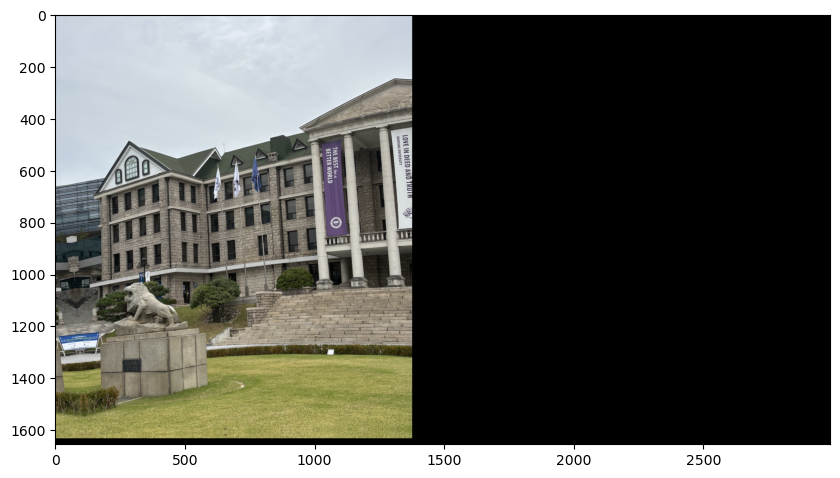

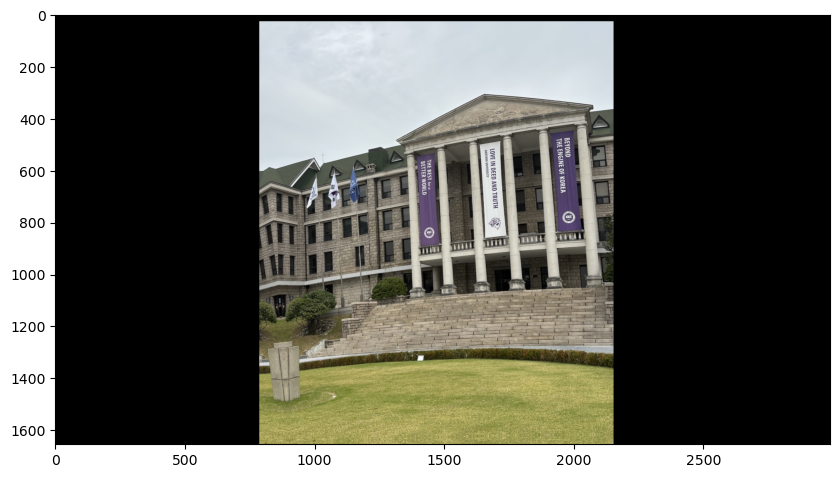

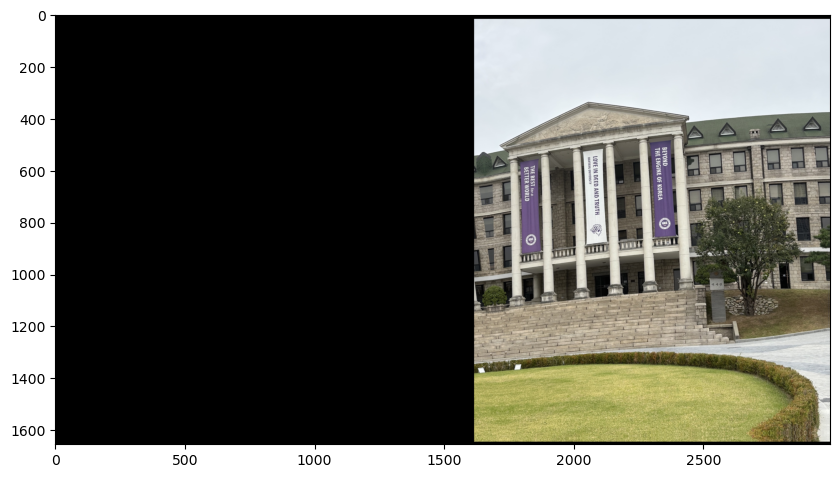

In [55]:
from stitching.timelapser import Timelapser

timelapser = Timelapser('as_is')
timelapser.initialize(final_corners, final_sizes)

for img, corner in zip(warped_final_imgs, final_corners):
    timelapser.process_frame(img, corner)
    frame = timelapser.get_frame()
    plot_image(frame, (10,10))

In [56]:
from stitching.cropper import Cropper

cropper = Cropper()

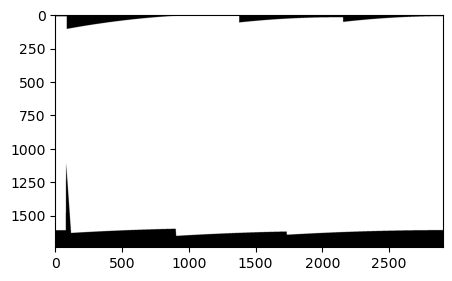

In [57]:
mask = cropper.estimate_panorama_mask(warped_final_imgs, warped_final_masks, final_corners, low_sizes)
plot_image(mask, (5,5))

In [58]:
lir = cropper.estimate_largest_interior_rectangle(mask)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [59]:
lir = cropper.estimate_largest_interior_rectangle(mask)
print(lir)

Rectangle(x=np.uint32(118), y=np.uint32(106), width=np.uint32(2784), height=np.uint32(1496))


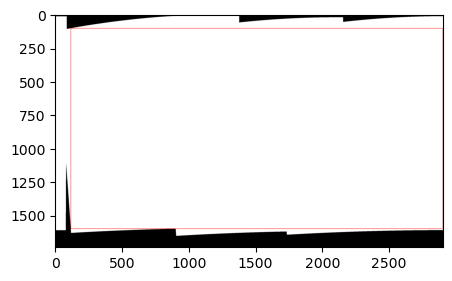

In [60]:
plot = lir.draw_on(mask, size=2)
plot_image(plot, (5,5))

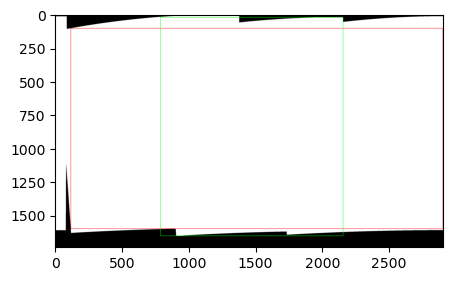

In [61]:
final_corners = cropper.get_zero_center_corners(final_corners)
rectangles = cropper.get_rectangles(final_corners, final_sizes)

plot = rectangles[1].draw_on(plot, (0, 255, 0), 2)  # The rectangle of the center img
plot_image(plot, (5,5))

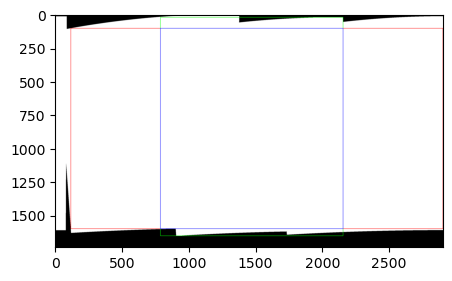

In [62]:
overlap = cropper.get_overlap(rectangles[1], lir)
plot = overlap.draw_on(plot, (255, 0, 0), 2)
plot_image(plot, (5,5))

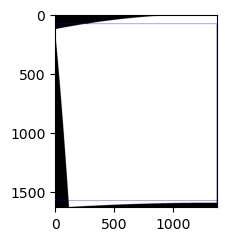

In [63]:
intersection = cropper.get_intersection(rectangles[1], overlap)
plot = intersection.draw_on(warped_final_masks[1], (255, 0, 0), 2)
plot_image(plot, (2.5,2.5))

In [64]:
cropper.prepare(warped_final_imgs, warped_final_masks, final_corners, low_sizes)

cropped_low_masks = list(cropper.crop_images(warped_final_masks))
cropped_low_imgs = list(cropper.crop_images(warped_final_imgs))
low_corners, low_sizes = cropper.crop_rois(final_corners, low_sizes)

lir_aspect = images.get_ratio(Images.Resolution.LOW, Images.Resolution.FINAL)  # since lir was obtained on low imgs
cropped_final_masks = list(cropper.crop_images(warped_final_masks, lir_aspect))
cropped_final_imgs = list(cropper.crop_images(warped_final_imgs, lir_aspect))
final_corners, final_sizes = cropper.crop_rois(final_corners, final_sizes, lir_aspect)

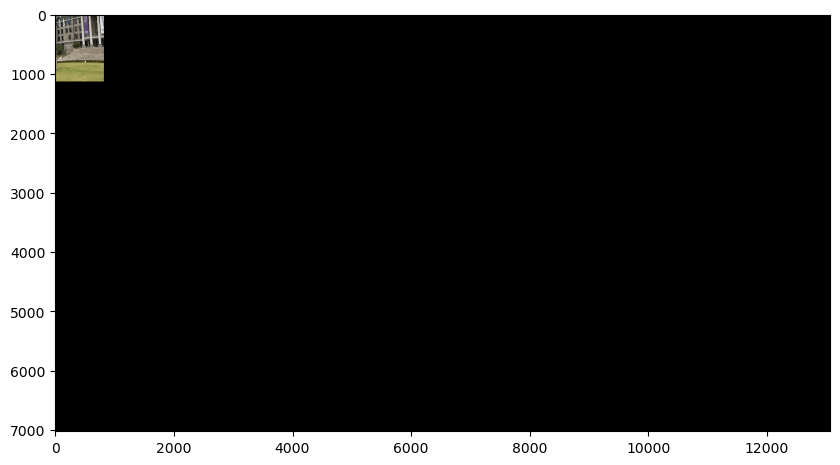

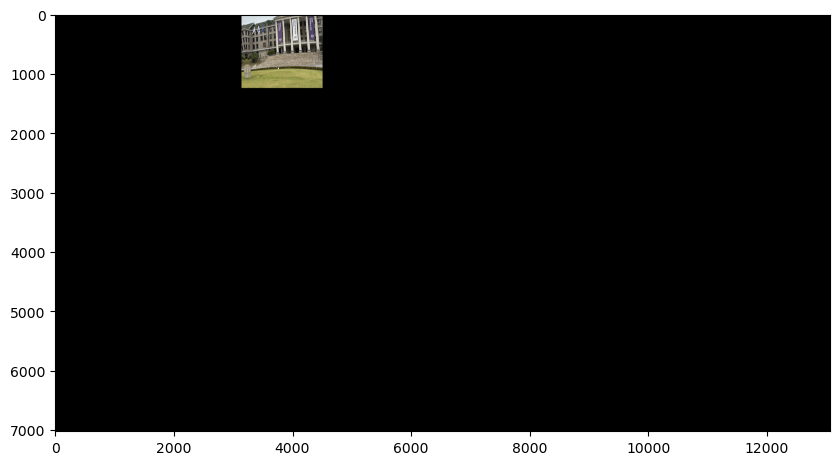

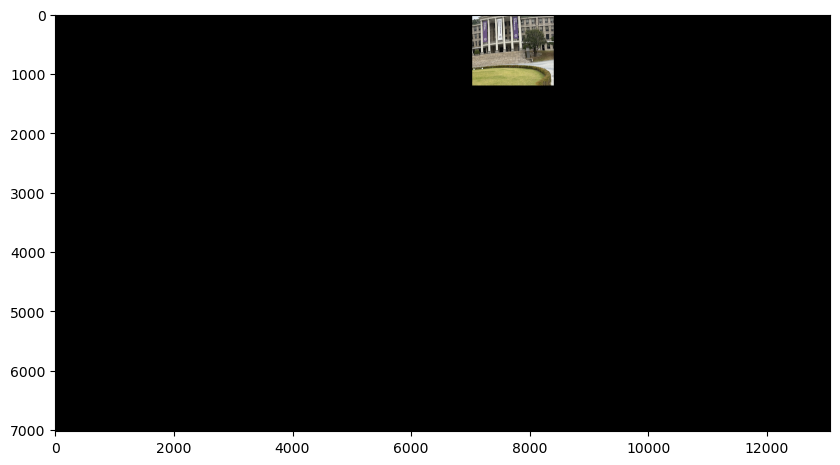

In [65]:
timelapser = Timelapser('as_is')
timelapser.initialize(final_corners, final_sizes)

for img, corner in zip(cropped_final_imgs, final_corners):
    timelapser.process_frame(img, corner)
    frame = timelapser.get_frame()
    plot_image(frame, (10,10))